In [1]:
from geosnap import DataStore
from geosnap import io as gio

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/Users/knaaptime/Dropbox/projects/rypyrx/.pixi/envs/default/lib/python3.12/site-packages/pointpats/pointpattern.py:277: SyntaxWarning: invalid escape sequence '\m'
  """
/Users/knaaptime/Dropbox/projects/rypyrx/.pixi/envs/default/lib/python3.12/site-packages/pointpats/process.py:159: SyntaxWarning: invalid escape sequence '\l'
  """
/Users/knaaptime/Dropbox/projects/rypyrx/.pixi/envs/default/lib/python3.12/site-packages/pointpats/process.py:296: SyntaxWarning: invalid escape sequence '\l'
  """
/Users/knaaptime/Dropbox/projects/rypyrx/.pixi/envs/default/lib/python3.12/site-packages/jsonlines/jsonlines.py:301: SyntaxWarning: invalid escape sequence '\*'
  """


In [2]:
gio.store_acs(years=2018, level='bg', data_dir="../data")

Loading manifest: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:00<00:00, 22.3k/s]
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 921M/921M [00:20<00:00, 44.2MB/s]


In [3]:
datasets = DataStore("../data/")

In [4]:
sd = gio.get_acs(datasets, years=2018, county_fips='06073')

/Users/knaaptime/Dropbox/projects/rypyrx/.pixi/envs/default/lib/python3.12/site-packages/geosnap/io/constructors.py:215: UserWarning: Currency columns unavailable at this resolution; not adjusting for inflation
  warn(


In [5]:
sd.head()

,geoid,n_persons_under_18,n_persons_over_60,n_persons_over_75,n_persons_over_15,n_married,n_widowed_divorced,n_total_families,n_female_headed_families,n_nonhisp_white_persons,...,p_nonhisp_white_persons,p_nonhisp_black_persons,p_hispanic_persons,p_native_persons,p_asian_persons,p_hawaiian_persons,p_asian_indian_persons,p_veterans,geometry,year
0,060730001001,402.0,440.0,142.0,1230.0,401.0,243.0,420.0,0.0,1177.0,...,74.635384,0.000000,20.418516,0.000000,2.726696,1.014585,2.726696,5.707039,"MULTIPOLYGON (((-117.19208 32.75917, -117.1918...",2018
1,060730001002,162.0,812.0,266.0,1570.0,490.0,263.0,497.0,0.0,1315.0,...,78.601315,0.000000,11.595935,0.000000,5.917513,0.000000,5.917513,12.432756,"MULTIPOLYGON (((-117.1949 32.75278, -117.19471...",2018
2,060730002011,311.0,651.0,256.0,1624.0,368.0,427.0,434.0,0.0,1616.0,...,84.386423,0.522193,7.049608,0.469974,2.140992,0.000000,2.140992,4.751958,"MULTIPOLYGON (((-117.17887 32.75765, -117.1779...",2018
3,060730002021,191.0,174.0,43.0,1157.0,144.0,285.0,193.0,0.0,1093.0,...,85.995279,0.000000,8.339890,0.000000,3.933910,0.000000,3.933910,3.933910,"MULTIPOLYGON (((-117.18241 32.74255, -117.1819...",2018
4,060730002022,91.0,134.0,26.0,629.0,129.0,117.0,130.0,0.0,653.0,...,93.956835,0.000000,4.172662,0.000000,0.000000,0.000000,0.000000,4.028777,"MULTIPOLYGON (((-117.18404 32.74571, -117.1838...",2018


In [6]:
m = sd[['geoid', 'geometry']].explore()
m

In [7]:
from esda import Moran_Local
from libpysal.graph import Graph

In [8]:
sd = sd[sd.geoid!='060739901000']

In [9]:
g = Graph.build_contiguity(sd)

In [10]:
m = sd[['geoid', 'geometry']].explore(tiles='CartoDB Positron')
m = g.explore(sd[['geoid', 'geometry']],m=m)

In [11]:
m

In [12]:
m.save("../paper/_fig_sdmap.html")

write the map into a standalone html file

In [13]:
import matplotlib.pyplot as plt

save a static image

<Axes: >

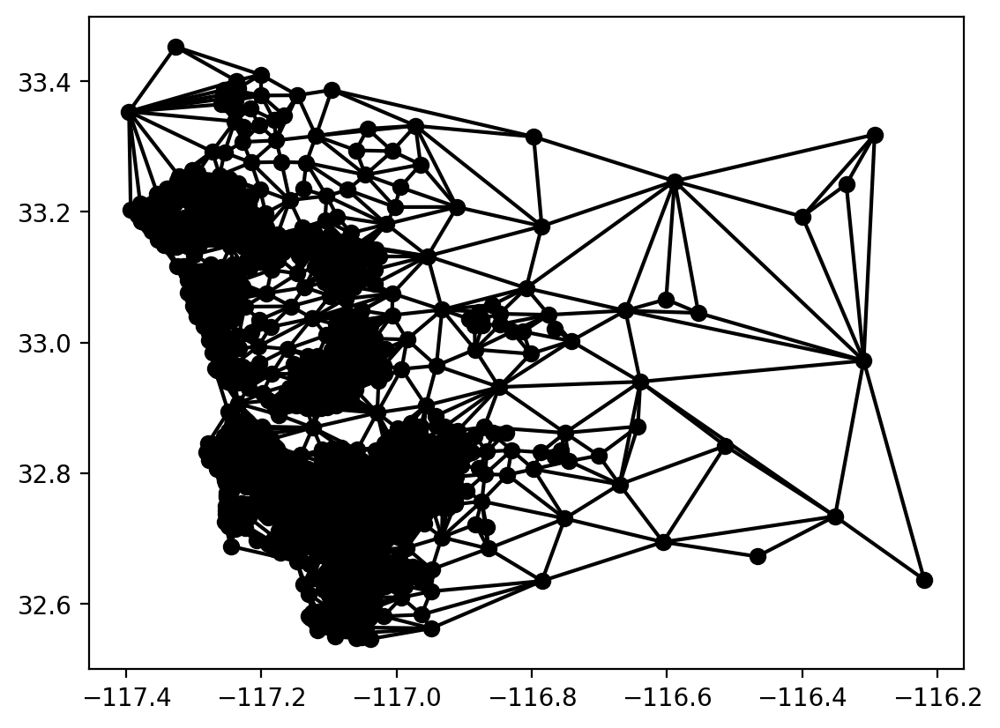

In [14]:
g.plot(sd)

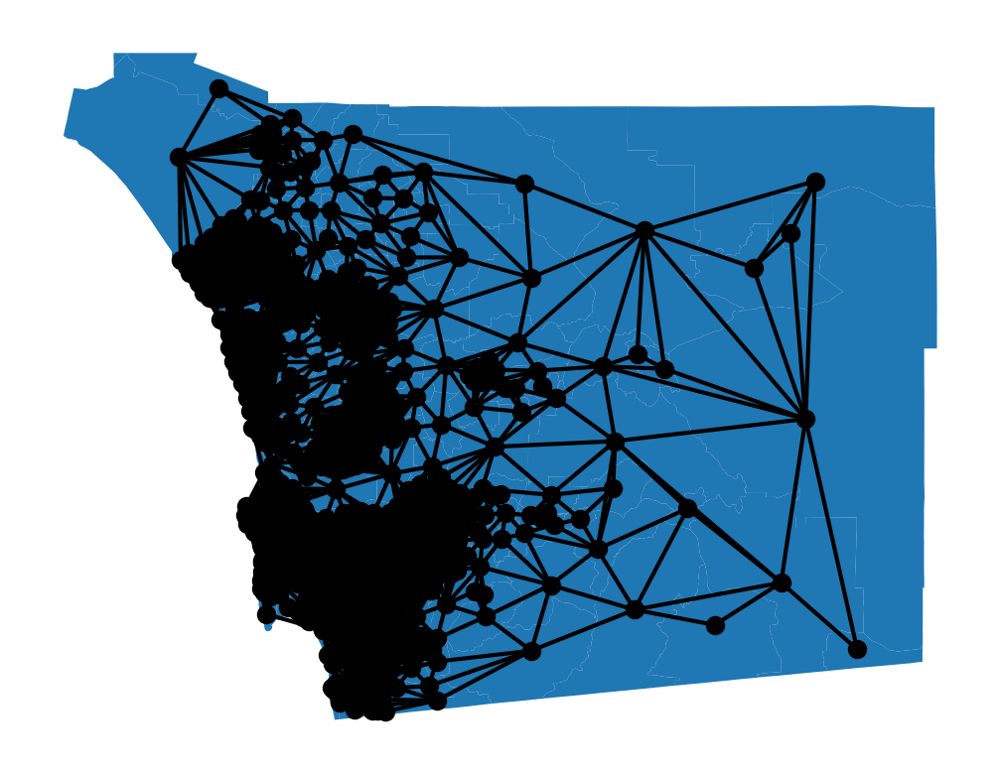

In [15]:
f, ax = plt.subplots()


sd.plot(ax=ax)
g.plot(sd, ax=ax)

ax.axis('off')
plt.savefig("../paper/_fig_sdmap.png")

write out an html version and a latex version

In [16]:
table = sd[['n_total_pop', 'median_household_income']].head(10)
table.columns = table.columns.str.replace("_","-")

table.to_html("../paper/_table_sd_table.html", index=False)
table.to_latex("../paper/_table_sd_table.md", longtable=True, caption='Blockgroups in San Diego')

In [17]:
table

,n-total-pop,median-household-income
0,1577.0,150688.0
1,1673.0,127292.0
2,1915.0,90673.0
3,1271.0,65219.0
4,695.0,NaN
5,2617.0,81250.0
6,500.0,64631.0
7,808.0,64787.0
8,1682.0,59010.0
9,1151.0,79725.0
